In [1]:
import torch
from diffusers.utils import load_image, make_image_grid
import numpy as np
from PIL import Image
import os
import glob
import cv2
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import random
import tensorflow as tf
from tensorflow import keras
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import pandas as pd
import plotly.express as px
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.cluster import FeatureAgglomeration
from sklearn.manifold import Isomap
import umap

c:\Users\Will Poulett\AppData\Local\Programs\Python\Python311\Lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\Will Poulett\AppData\Local\Programs\Python\Python311\Lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\Will Poulett\AppData\Local\Pr

In [2]:
image_paths = []

for folder in os.listdir("cat_dog_example_images"):
    fileList = glob.glob(f'cat_dog_example_images/{folder}/*')
    image_paths.extend(fileList)

test_files  = []
test_labels = []

dir_path_test = "cat_dog_model/data/test_set/test_set"

for folder in os.listdir(dir_path_test):
    
    fileList = glob.glob(f'{dir_path_test}/{folder}/*')
    test_labels.extend([f"{folder}_test" for _ in fileList][0:100])
    test_files.extend(fileList[0:100])

In [3]:
all_image_paths = image_paths + test_files 
all_labels      = image_paths + test_labels

all_images_array = []
all_images = []

for file in all_image_paths:
    im = cv2.imread(file)
    if "edge_case_images" not in file:
        im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    im = cv2.resize(im, (256,256))
    all_images_array.append(im)
    all_images.append(Image.fromarray(im.astype(np.uint8)))

In [4]:
len(all_images)

327

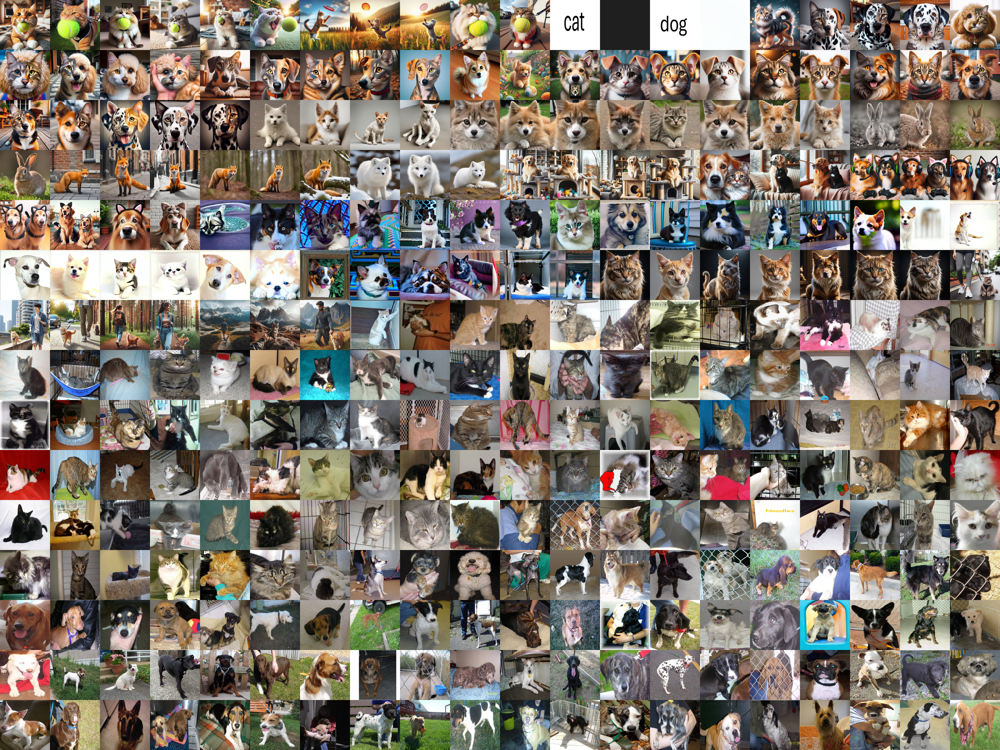

In [6]:
make_image_grid(all_images[0:300],15, 20)

In [7]:
model = keras.models.load_model("cat_dog_model/models/best_model_epoch_03.h5")
activations_model = keras.Model(model.input,model.layers[-2].output)

In [9]:
all_predictions = model.predict(np.array(all_images_array))
all_predictions_argmax = [np.argmax(pred) for pred in all_predictions]
all_activations = activations_model.predict(np.array(all_images_array))

11/11 [==============================] - 17s 1s/step


In [10]:
projections = TSNE(2,random_state=1).fit_transform(np.stack(all_activations))
TSNE_x = [x[0] for x in projections]
TSNE_y = [x[1] for x in projections]

In [11]:
projections = PCA(2,random_state=1).fit_transform(np.stack(all_activations))
PCA_x = [x[0] for x in projections]
PCA_y = [x[1] for x in projections]

In [12]:
projections = FeatureAgglomeration(n_clusters=2).fit_transform(np.stack(all_activations))
FA_x = [x[0] for x in projections]
FA_y = [x[1] for x in projections]

In [13]:
projections = Isomap(n_components=2).fit_transform(np.stack(all_activations))
IS_x = [x[0] for x in projections]
IS_y = [x[1] for x in projections]

In [14]:
projections = umap.UMAP().fit_transform(np.stack(all_activations))
UM_x = [x[0] for x in projections]
UM_y = [x[1] for x in projections]

In [25]:
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import ColumnDataSource, HoverTool, BoxSelectTool, CustomJS, Slider
from bokeh.layouts import column, row
from bokeh.models.widgets import Div, Button

# Ensure Bokeh outputs to the notebook
output_notebook()

c = ["blue", "green"]
v = ["Cats", "Dogs"]
colours = [c[p] for p in all_predictions_argmax]
labels  = [v[p] for p in all_predictions_argmax]

new_colours = []
for c, l in zip(colours,all_labels):
    if "test" in l:
        new_colours.append(f"light{c}")
    else:
        new_colours.append(c)
colours = new_colours     
    

coordinates_list = [dict(x=TSNE_x, y=TSNE_y),
                    dict(x=PCA_x,  y=PCA_y),
                    dict(x=FA_x,y=FA_y),
                    dict(x=IS_x,y=IS_y),
                    dict(x=UM_x, y=UM_y)]

# Create a ColumnDataSource
source = ColumnDataSource(data=dict(x=coordinates_list[0]['x'], y=coordinates_list[0]['y'], images=all_image_paths, colours=colours, label = labels))

# Create a figure
p = figure(plot_width=600, plot_height=400, tools="")

# Add scatter renderer
p.scatter('x', 'y', size=10, source=source, color = "colours", legend_field = "label")
p.legend.title = "Prediction"
p.add_layout(p.legend[0], 'right')

# Create a HoverTool with custom HTML to display the image
hover = HoverTool(tooltips="""
    <div>
        <div>
            <img
                src="@images" height="100" alt="@images" width="100"
                style="float: left; margin: 0px 0px 0px 0px;"
                border="0px"
            ></img>
        </div>
    </div>
""")

# Add the hover tool to the figure
p.add_tools(hover)

# Add a BoxSelectTool to the figure
box_select = BoxSelectTool()
p.add_tools(box_select)

# Create a Div to display the images
div = Div(width=600)

# CustomJS callback to update the Div with the selected images
callback = CustomJS(args=dict(source=source, div=div), code="""
    const indices = source.selected.indices;
    let images = '';
    for (let i = 0; i < indices.length; i++) {
        const index = indices[i];
        images += `<img src="${source.data.images[index]}" height="100" alt="Image" width="100" style="margin: 5px; border: 2px solid ${source.data.colours[index]};"/>`;
    }
    div.text = images;
""")

# Add the callback to the source's selected property
source.selected.js_on_change('indices', callback)

# Create Slider object 
slider = Slider(start=0, end=len(coordinates_list)-1, value=0, 
                step=1, title='Dimension Reduction Method') 

slider_callback = CustomJS(args=dict(source=source, coords_list=coordinates_list, val=slider ), code="""
    source.data.x = coords_list[val.value].x;
    source.data.y = coords_list[val.value].y;
    source.change.emit();
""")

slider.js_on_change('value', slider_callback) 

# Layout the plot, div, and button
layout = row(column(p, slider),div)

# Show the plot
show(layout)

Loading BokehJS ...

In [21]:
colours

['green',
 'green',
 'green',
 'blue',
 'green',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'green',
 'green',
 'green',
 'green',
 'green',
 'blue',
 'green',
 'green',
 'green',
 'blue',
 'blue',
 'blue',
 'green',
 'blue',
 'green',
 'green',
 'blue',
 'blue',
 'green',
 'green',
 'green',
 'green',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'green',
 'blue',
 'blue',
 'green',
 'green',
 'green',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'green',
 'blue',
 'blue',
 'blue',
 'blue',
 'green',
 'blue',
 'blue',
 'green',
 'green',
 'blue',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'blue',
 'blue',
 'blue',
 'green',
 'green',
 'green',
 'green',
 'blue',
 'green',
 'blue',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'blue',
 'blue',
 